### 0. Imports

In [1]:
import preprocessing
import plots

import os
import random
import pandas as pd
import numpy as np
import scanpy as sc
import anndata as ad
from scipy import sparse
import scanpy.external as sce
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
from anndata import ImplicitModificationWarning

warnings.filterwarnings("ignore", category=ImplicitModificationWarning)

In [2]:
sc.settings.verbosity = 0
sc.set_figure_params(dpi=150, dpi_save=300, frameon=False, format='png')
pd.set_option('display.max_rows', 5000)
plt.rcParams['axes.grid'] = False

In [3]:
!mkdir output_raw
output_path = 'output_raw'

In [34]:
import celltypist
from celltypist import models

In [30]:
import rpy2.rinterface_lib.callbacks
import anndata2ri
import logging

from rpy2.robjects import pandas2ri
from rpy2.robjects import r

rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

pandas2ri.activate()
anndata2ri.activate()

%load_ext rpy2.ipython

The rpy2.ipython extension is already loaded. To reload it, use:
  %reload_ext rpy2.ipython


/tmp/ipykernel_53308/3168876868.py:11: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  anndata2ri.activate()


In [31]:
%%R
.libPaths("/home/student/R/x86_64-pc-linux-gnu-library/4.4")

library(edgeR)

In [6]:
%%R

library(clusterProfiler)
library(enrichplot)
library(ggplot2)
library(stringr)


clusterProfiler v4.12.0  For help: https://yulab-smu.top/biomedical-knowledge-mining-book/

If you use clusterProfiler in published research, please cite:
T Wu, E Hu, S Xu, M Chen, P Guo, Z Dai, T Feng, L Zhou, W Tang, L Zhan, X Fu, S Liu, X Bo, and G Yu. clusterProfiler 4.0: A universal enrichment tool for interpreting omics data. The Innovation. 2021, 2(3):100141

Attaching package: ‘clusterProfiler’

The following object is masked from ‘package:stats’:

    filter



In [18]:
%%R
# set the organism db for clusterProfiler GSEA
organism = "org.Hs.eg.db"
# BiocManager::install(organism, character.only = TRUE, force=TRUE)
library(organism, character.only = TRUE)

Loading required package: AnnotationDbi
Loading required package: stats4
Loading required package: BiocGenerics

Attaching package: ‘BiocGenerics’

The following object is masked from ‘package:limma’:

    plotMA

The following objects are masked from ‘package:stats’:

    IQR, mad, sd, var, xtabs

The following objects are masked from ‘package:base’:

    anyDuplicated, aperm, append, as.data.frame, basename, cbind,
    colnames, dirname, do.call, duplicated, eval, evalq, Filter, Find,
    get, grep, grepl, intersect, is.unsorted, lapply, Map, mapply,
    match, mget, order, paste, pmax, pmax.int, pmin, pmin.int,
    Position, rank, rbind, Reduce, rownames, sapply, setdiff, table,
    tapply, union, unique, unsplit, which.max, which.min

Loading required package: Biobase
Welcome to Bioconductor

    Vignettes contain introductory material; view with
    'browseVignettes()'. To cite Bioconductor, see
    'citation("Biobase")', and for packages 'citation("pkgname")'.

Loading required p

### 1. Preprocessing, PBMC clustering

Adata object created!

Run QC and preprocessing...
Total number of cells: 581467
Number of cells after filtering of low quality cells: 536653

Normalizing, logarithming...

Select HVG...


/opt/conda/envs/scenv/lib/python3.11/site-packages/scanpy/preprocessing/_scale.py:299: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)



QC and preprocessing done!


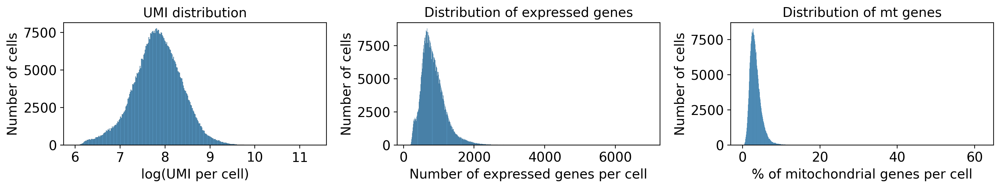

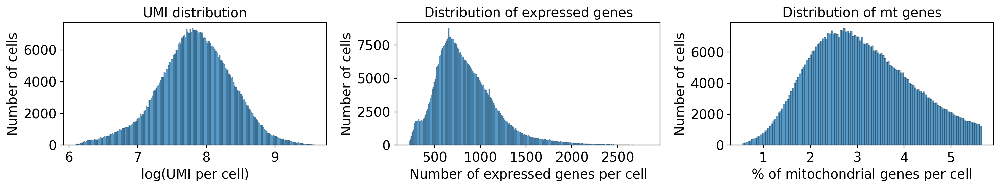

In [4]:
SEED = 89
random.seed(SEED)  # have to call random.seed() with the same value prior to every invocation of random.sample()
np.random.seed(SEED)

n_batches = 1
n_samples = 300
samples_path = './single_matrices/'

for batch in range(1, n_batches+1):
    adata = preprocessing.get_adata_from_multiple_samples(samples_path, n_samples, make_sparse=True)
    # output_path = f'./output/batch_{batch}'
    if not os.path.exists(output_path):
        os.makedirs(output_path)
    adata.obs.to_csv(f'{output_path}/metadata.csv')
    print('Adata object created!')

    print('\nRun QC and preprocessing...')
    adata = preprocessing.qc_and_preprocess_to_pca(adata, output_path)
    adata.write(os.path.join(output_path, 'adata_after_QC.h5ad'))
    print('\nQC and preprocessing done!')

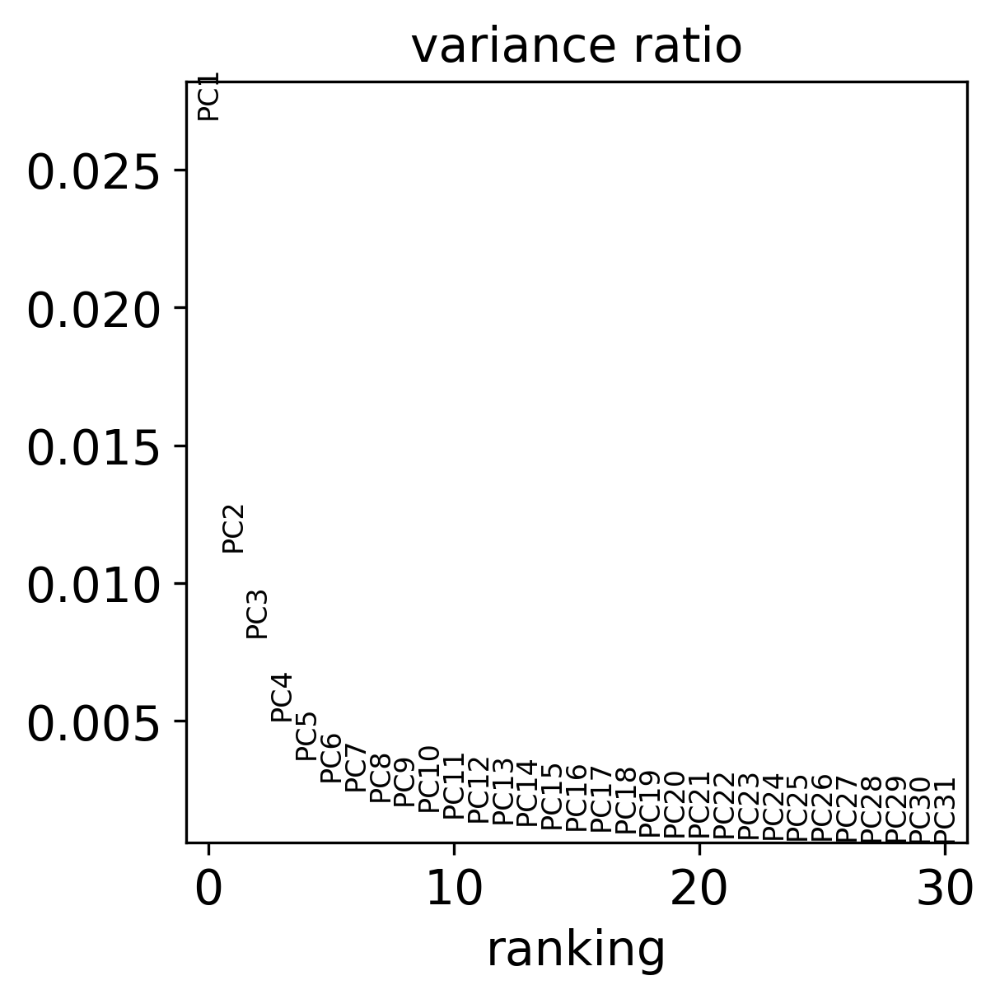

In [5]:
sc.pl.pca_variance_ratio(adata)

In [6]:
adata

AnnData object with n_obs × n_vars = 536653 × 3000
    obs: 'nCount_RNA', 'nFeature_RNA', 'donor_id', 'pool_number', 'predicted.celltype.l2', 'predicted.celltype.l2.score', 'age', 'sex', 'dataset', 'ct_cov', 'ethnicity', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'outlier', 'mt_outlier', 'n_genes'
    var: 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'counts', 'log_counts'

In [6]:
adata.obs.drop(columns=['nCount_RNA', 'nFeature_RNA', 
                        'predicted.celltype.l2', 'predicted.celltype.l2.score'],
               inplace=True)

In [10]:
# 3. BATCH CORRECTION
sce.pp.harmony_integrate(adata, 'donor_id', max_iter_harmony=20)

2024-05-12 04:16:59,930 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-05-12 04:17:15,688 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-05-12 04:17:17,987 - harmonypy - INFO - Iteration 1 of 20
2024-05-12 04:24:04,346 - harmonypy - INFO - Iteration 2 of 20
2024-05-12 04:30:18,747 - harmonypy - INFO - Iteration 3 of 20
2024-05-12 04:36:16,808 - harmonypy - INFO - Iteration 4 of 20
2024-05-12 04:42:16,124 - harmonypy - INFO - Iteration 5 of 20
2024-05-12 04:46:08,619 - harmonypy - INFO - Iteration 6 of 20
2024-05-12 04:50:00,657 - harmonypy - INFO - Converged after 6 iterations


In [11]:
# 4. CLUSTERING
sc.pp.neighbors(
    adata,
    n_pcs=20,
    n_neighbors=15,
    knn=True,
    use_rep="X_pca_harmony"
)

In [12]:
print('\nClustering...')
sc.tl.leiden(adata, resolution=0.6, flavor='igraph')
print('\nMake dendrogram...')
sc.tl.dendrogram(adata, groupby="leiden", n_pcs=20, use_rep="X_pca_harmony", linkage_method="single")


Clustering...

Make dendrogram...


In [13]:
sc.tl.paga(adata)
sc.pl.paga(adata, plot=False)
sc.tl.umap(adata, init_pos='paga')

In [14]:
adata.write(os.path.join(output_path, 'adata_leiden_main.h5ad'))

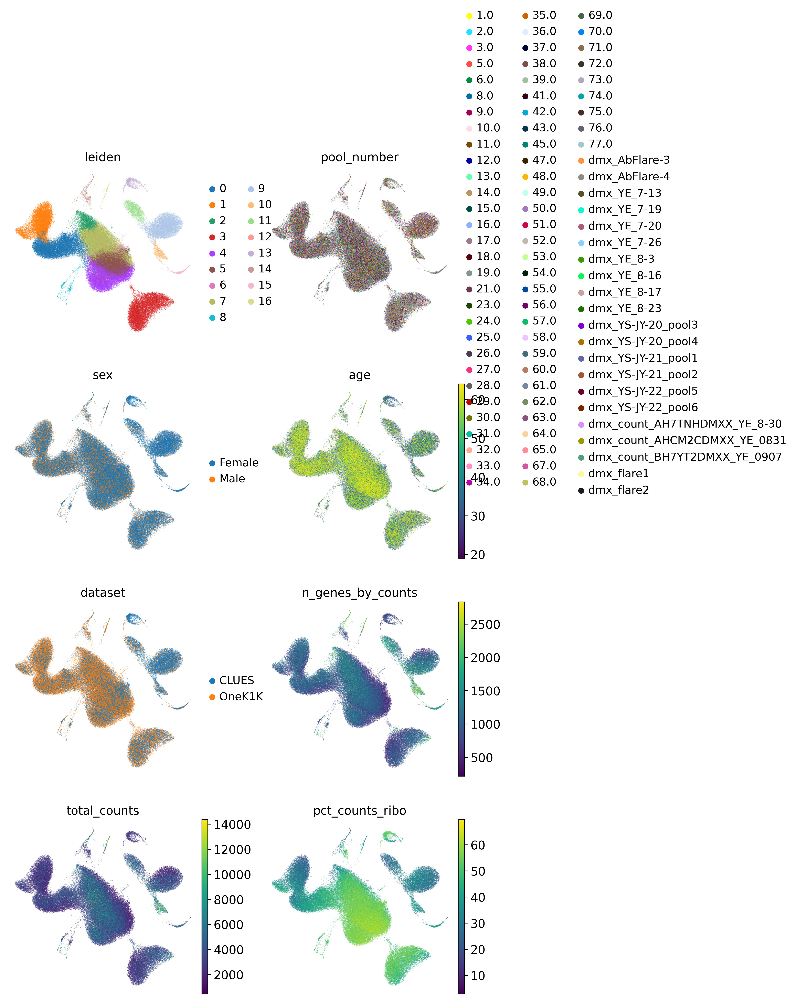

In [19]:
sc.pl.umap(adata, color=['leiden', 'pool_number', 'sex', 'age', 'dataset', 'n_genes_by_counts', 'total_counts', 'pct_counts_ribo'], frameon=False, ncols=2)

In [16]:
adata

AnnData object with n_obs × n_vars = 536653 × 3000
    obs: 'donor_id', 'pool_number', 'age', 'sex', 'dataset', 'ct_cov', 'ethnicity', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'outlier', 'mt_outlier', 'n_genes', 'leiden'
    var: 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'leiden', 'dendrogram_leiden', 'paga', 'leiden_sizes', 'umap', 'leiden_colors'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'counts', 'log_counts'
    obsp: 'distances', 'connectivities'

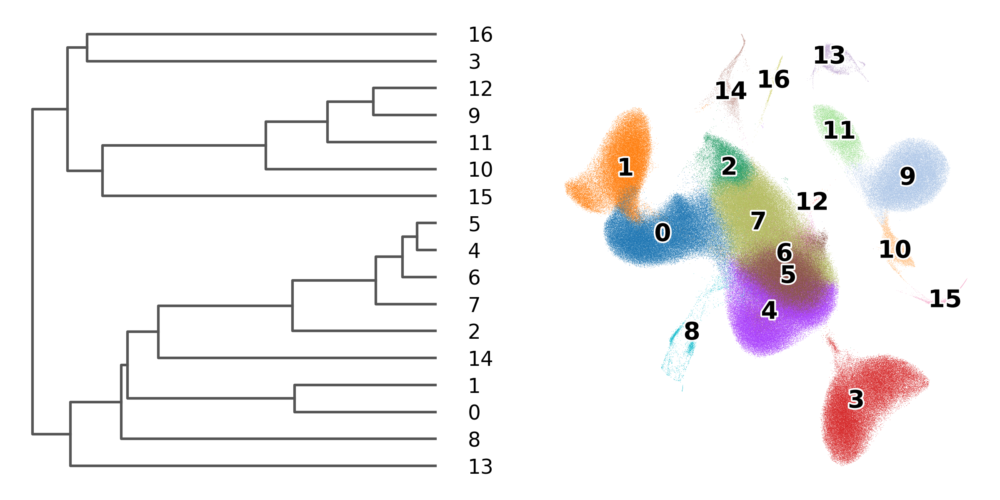

In [17]:
plots.plot_leiden_clusters(adata) #, save_fig_to=output_path, suffix='all')

### 2. PBMC annotation with `celltypist`

In [35]:
adata_celltypist = adata.copy()  # make a copy of our adata
adata_celltypist.X = adata.layers["counts"]  # set adata.X to raw counts
sc.pp.normalize_per_cell(
    adata_celltypist, counts_per_cell_after=10**4
)  # normalize to 10,000 counts per cell
sc.pp.log1p(adata_celltypist)  # log-transform
# make .X dense instead of sparse, for compatibility with celltypist:
adata_celltypist.X = adata_celltypist.X.toarray()

In [41]:
models.download_models(force_update = True)

In [42]:
models.models_description()

,model,description
0,Immune_All_Low.pkl,immune sub-populations combined from 20 tissue...
1,Immune_All_High.pkl,immune populations combined from 20 tissues of...
2,Adult_CynomolgusMacaque_Hippocampus.pkl,cell types from the hippocampus of adult cynom...
3,Adult_Human_PancreaticIslet.pkl,cell types from pancreatic islets of healthy a...
4,Adult_Human_Skin.pkl,cell types from human healthy adult skin
5,Adult_Mouse_Gut.pkl,cell types in the adult mouse gut combined fro...
6,Adult_Mouse_OlfactoryBulb.pkl,cell types from the olfactory bulb of adult mice
7,Adult_Pig_Hippocampus.pkl,cell types from the adult pig hippocampus
8,Adult_RhesusMacaque_Hippocampus.pkl,cell types from the hippocampus of adult rhesu...
9,Autopsy_COVID19_Lung.pkl,cell types from the lungs of 16 SARS-CoV-2 inf...


In [36]:
model_pbmc = models.Model.load(model="Healthy_COVID19_PBMC.pkl")

In [37]:
model_pbmc.description

{'date': '2022-03-10 05:08:08.224597',
 'details': 'peripheral blood mononuclear cell types from healthy and COVID-19 individuals',
 'url': 'https://celltypist.cog.sanger.ac.uk/models/COVID19_PBMC_Haniffa/v1/Healthy_COVID19_PBMC.pkl',
 'source': 'https://doi.org/10.1038/s41591-021-01329-2',
 'version': 'v1',
 'number_celltypes': 51}

In [38]:
model_pbmc.cell_types

array(['ASDC', 'B_exhausted', 'B_immature', 'B_malignant', 'B_naive',
       'B_non-switched_memory', 'B_switched_memory', 'C1_CD16_mono',
       'CD14_mono', 'CD16_mono', 'CD4.CM', 'CD4.EM', 'CD4.IL22',
       'CD4.Naive', 'CD4.Prolif', 'CD4.Tfh', 'CD4.Th1', 'CD4.Th17',
       'CD4.Th2', 'CD8.EM', 'CD8.Naive', 'CD8.Prolif', 'CD8.TE',
       'CD83_CD14_mono', 'DC1', 'DC2', 'DC3', 'DC_prolif', 'HSC_CD38neg',
       'HSC_CD38pos', 'HSC_MK', 'HSC_erythroid', 'HSC_myeloid',
       'HSC_prolif', 'ILC1_3', 'ILC2', 'MAIT', 'Mono_prolif', 'NKT',
       'NK_16hi', 'NK_56hi', 'NK_prolif', 'Plasma_cell_IgA',
       'Plasma_cell_IgG', 'Plasma_cell_IgM', 'Plasmablast', 'Platelets',
       'RBC', 'Treg', 'gdT', 'pDC'], dtype=object)

In [50]:
ct_preds = celltypist.annotate(
    adata_celltypist,
    model=model_pbmc,
    majority_voting=True,
    # min_prop=0.6
)

🔬 Input data has 536653 cells and 3000 genes
🔗 Matching reference genes in the model
🧬 1372 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 30
🗳️ Majority voting the predictions
✅ Majority voting done!


In [51]:
ct_preds_adata = ct_preds.to_adata()

In [52]:
adata.obs["celltypist_annotation"] = ct_preds_adata.obs.loc[adata.obs.index, "majority_voting"]
adata.obs["celltypist_conf_score"] = ct_preds_adata.obs.loc[adata.obs.index, "conf_score"]

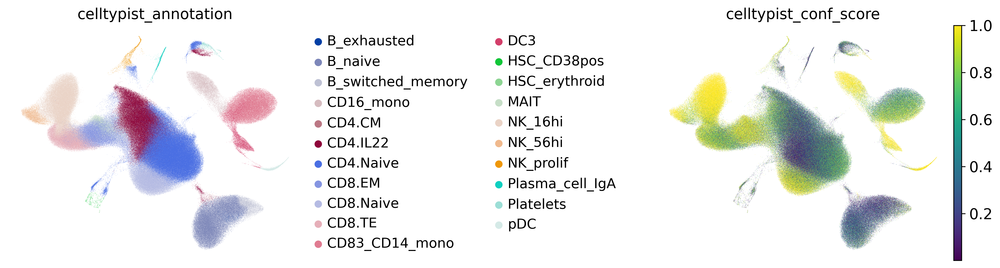

In [8]:
sc.pl.umap(
    adata,
    color=["celltypist_annotation", "celltypist_conf_score"],
    frameon=False,
    sort_order=False,
    wspace=1,
    # groups='CD8.Naive'
)

In [55]:
adata.write(os.path.join(output_path, 'adata_COVID_annotated.h5ad'))

In [12]:
adata.obs['celltypist_annotation'].value_counts()

CD4.Naive            170043
CD4.IL22              75196
NK_16hi               56848
B_naive               51755
CD8.Naive             43580
CD83_CD14_mono        37122
CD8.EM                32844
CD8.TE                24551
CD16_mono             10511
MAIT                   9251
DC3                    7658
NK_56hi                5318
B_switched_memory      4794
pDC                    2223
NK_prolif              1505
Plasma_cell_IgA         999
Platelets               975
B_exhausted             506
CD4.CM                  492
HSC_CD38pos             457
HSC_erythroid            25
Name: celltypist_annotation, dtype: int64

In [13]:
adata

AnnData object with n_obs × n_vars = 536653 × 3000
    obs: 'donor_id', 'pool_number', 'age', 'sex', 'dataset', 'ct_cov', 'ethnicity', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'outlier', 'mt_outlier', 'n_genes', 'leiden', 'celltypist_annotation', 'celltypist_conf_score'
    var: 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'celltypist_annotation_colors', 'dataset_colors', 'dendrogram_celltypist_annotation', 'dendrogram_leiden', 'hvg', 'leiden', 'leiden_colors', 'leiden_sizes', 'log1p', 'neighbors', 'paga', 'pca', 'pool_number_colors', 'sex_colors', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs

### 3. Select CD8 clusters

In [35]:
adata = sc.read_h5ad(os.path.join(output_path, 'adata_COVID_annotated.h5ad'))

In [5]:
adata.obs

,donor_id,pool_number,age,sex,dataset,ct_cov,ethnicity,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,...,pct_counts_mt,total_counts_ribo,log1p_total_counts_ribo,pct_counts_ribo,outlier,mt_outlier,n_genes,leiden,celltypist_annotation,celltypist_conf_score
AAACCTGAGCGATAGC-17,1025_1026,17.0,57.0,Female,OneK1K,NaN,NaN,1198,7.089243,3824.0,...,3.765690,1201.0,7.091742,31.406902,False,False,1198,0,CD8.TE,0.592421
AAACCTGAGCTACCTA-17,1025_1026,17.0,57.0,Female,OneK1K,NaN,NaN,974,6.882437,3342.0,...,2.932376,1463.0,7.288928,43.776180,False,False,974,3,B_naive,0.428429
AAACCTGCATGTCCTC-17,1025_1026,17.0,57.0,Female,OneK1K,NaN,NaN,842,6.736967,3653.0,...,2.737476,1833.0,7.514255,50.177937,False,False,842,4,CD4.Naive,0.032396
AAACGGGCAATGAATG-17,1025_1026,17.0,57.0,Female,OneK1K,NaN,NaN,622,6.434547,1805.0,...,3.878116,957.0,6.864848,53.019394,False,False,622,4,CD4.Naive,0.806948
AAACGGGCACTAAGTC-17,1025_1026,17.0,57.0,Female,OneK1K,NaN,NaN,919,6.824374,4706.0,...,2.592435,2740.0,7.916078,58.223545,False,False,919,4,CD4.Naive,0.110234
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTACTGTCCAATGGT-74,938_939,74.0,62.0,Male,OneK1K,NaN,NaN,785,6.666957,2284.0,...,2.802102,951.0,6.858565,41.637478,False,False,785,0,CD8.TE,0.995547
TTTATGCGTCTTTCAT-74,938_939,74.0,62.0,Male,OneK1K,NaN,NaN,648,6.475433,2211.0,...,2.306648,1220.0,7.107426,55.178654,False,False,648,7,CD4.IL22,0.591736
TTTCCTCTCGAATGGG-74,938_939,74.0,62.0,Male,OneK1K,NaN,NaN,593,6.386879,1941.0,...,3.760948,936.0,6.842683,48.222565,False,False,593,4,CD4.Naive,0.238441
TTTGCGCTCCACGTGG-74,938_939,74.0,62.0,Male,OneK1K,NaN,NaN,678,6.520621,1759.0,...,5.230245,578.0,6.361302,32.859577,False,False,678,0,CD8.TE,0.328158


In [8]:
adata.obs['sex'][adata.obs['sex'] == 'female'] = 'Female'
adata.obs['sex'][adata.obs['sex'] == 'male'] = 'Male'
adata.obs['sex'] = adata.obs['sex'].astype('object')
adata.obs['sex'] = adata.obs['sex'].astype('category')

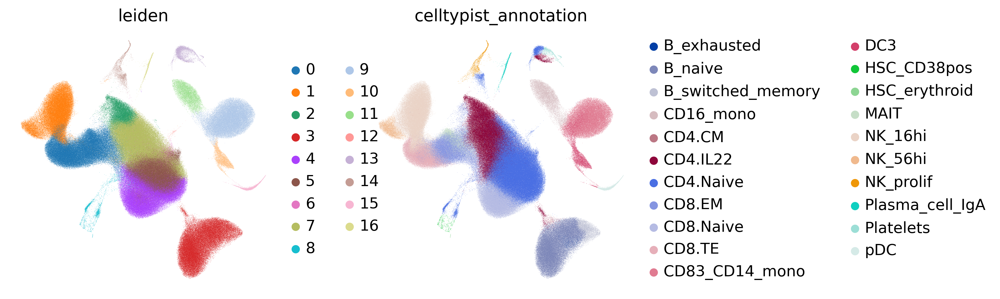

In [7]:
sc.pl.umap(
    adata,
    color=['leiden', "celltypist_annotation"],
    frameon=False,
    sort_order=False,
    # wspace=1,
)

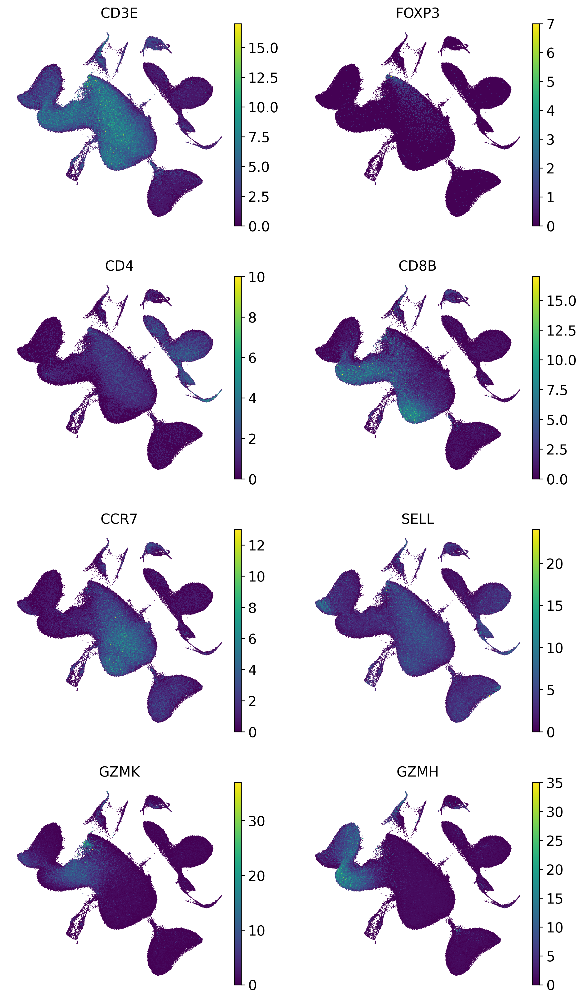

In [8]:
sc.pl.umap(adata, color=['CD3E', 'FOXP3', 'CD4', 'CD8B', 'CCR7', 'SELL', 'GZMK', 'GZMH'], 
           frameon=False, ncols=2, legend_loc="on data", size=3)

In [9]:
adata_cd8 = adata[[type in ('CD8.Naive', 'CD8.EM', 'CD8.TE') for type in adata.obs['celltypist_annotation']]]

In [10]:
(adata_cd8.X.T[adata_cd8.var_names == 'CD4'] > 0).sum()

2631

In [11]:
# drop CD4+ cells:
adata_cd8 = adata_cd8[adata_cd8.X.T[adata_cd8.var_names == 'CD4'] <= 0]

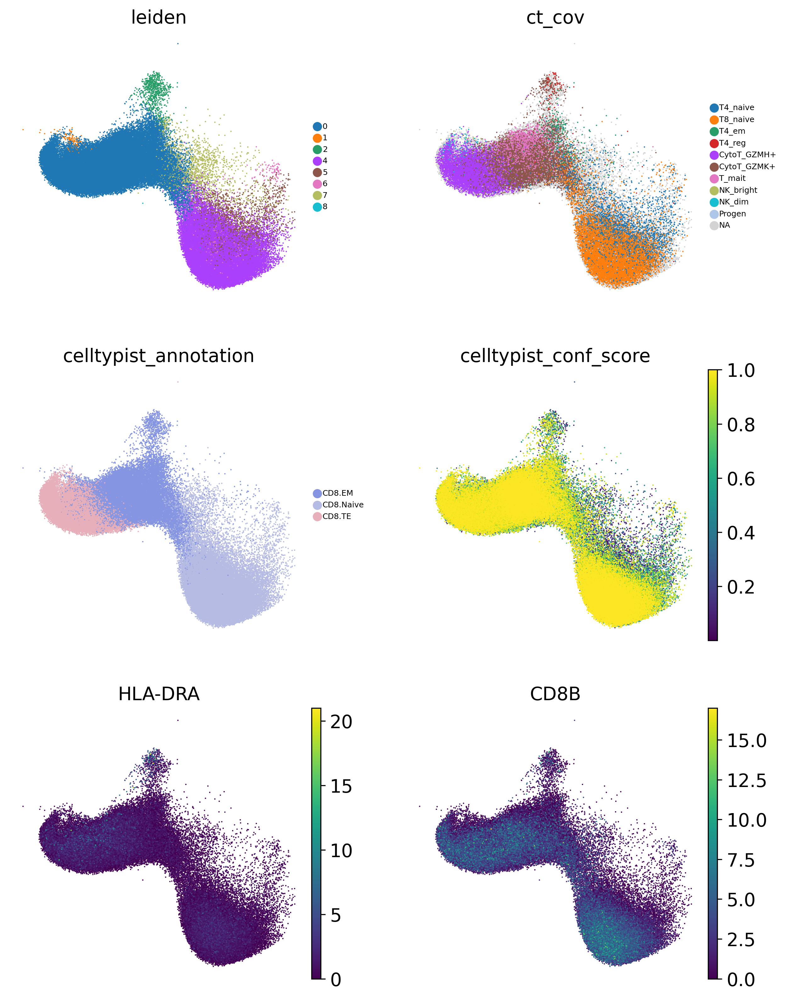

In [12]:
sc.pl.umap(adata_cd8, 
           color=['leiden', 'ct_cov', 'celltypist_annotation', 'celltypist_conf_score', 'HLA-DRA', 'CD8B'], 
           ncols=2, frameon=False, size=4, legend_fontsize=6, sort_order=True
           )

In [13]:
adata_cd8 = adata_cd8[[cluster not in ('2', '5', '6', '7', '8') for cluster in adata_cd8.obs['leiden']]]

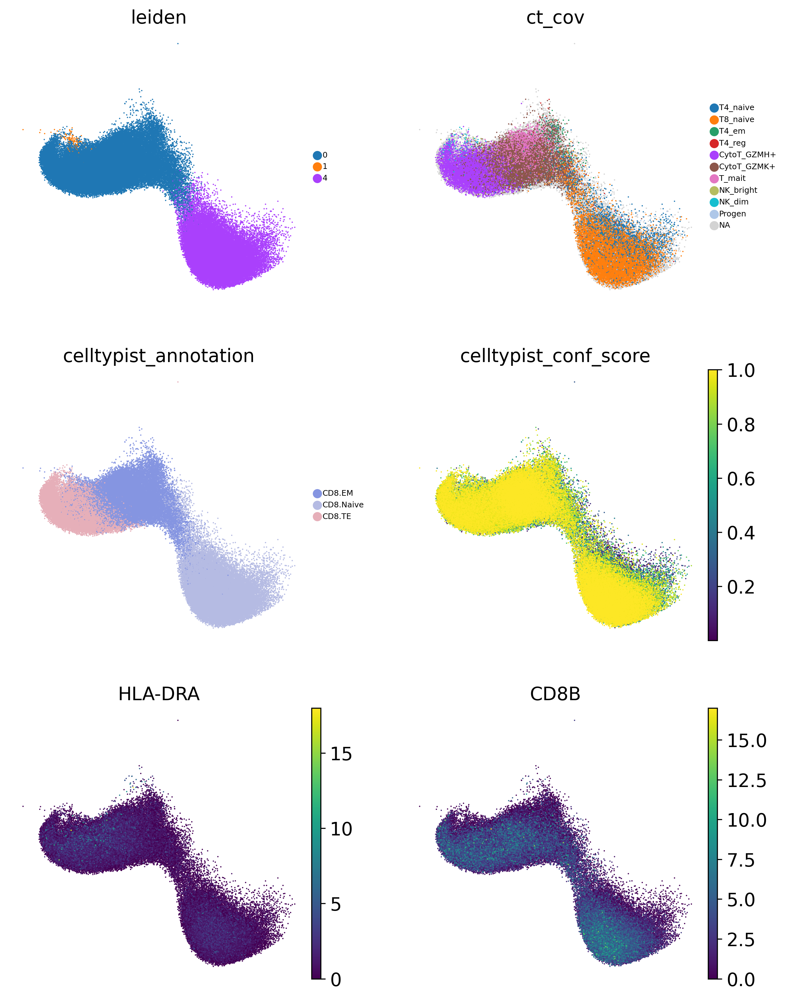

In [14]:
sc.pl.umap(adata_cd8, 
           color=['leiden', 'ct_cov', 'celltypist_annotation', 'celltypist_conf_score', 'HLA-DRA', 'CD8B'], 
           ncols=2, frameon=False, size=4, legend_fontsize=6, sort_order=True
           )

In [18]:
# return raw counts
adata_cd8.X = adata_cd8.layers['counts'].A.copy()

In [19]:
sc.pp.normalize_total(adata_cd8)
sc.pp.log1p(adata_cd8)

sc.pp.scale(adata_cd8)
sc.tl.pca(adata_cd8)

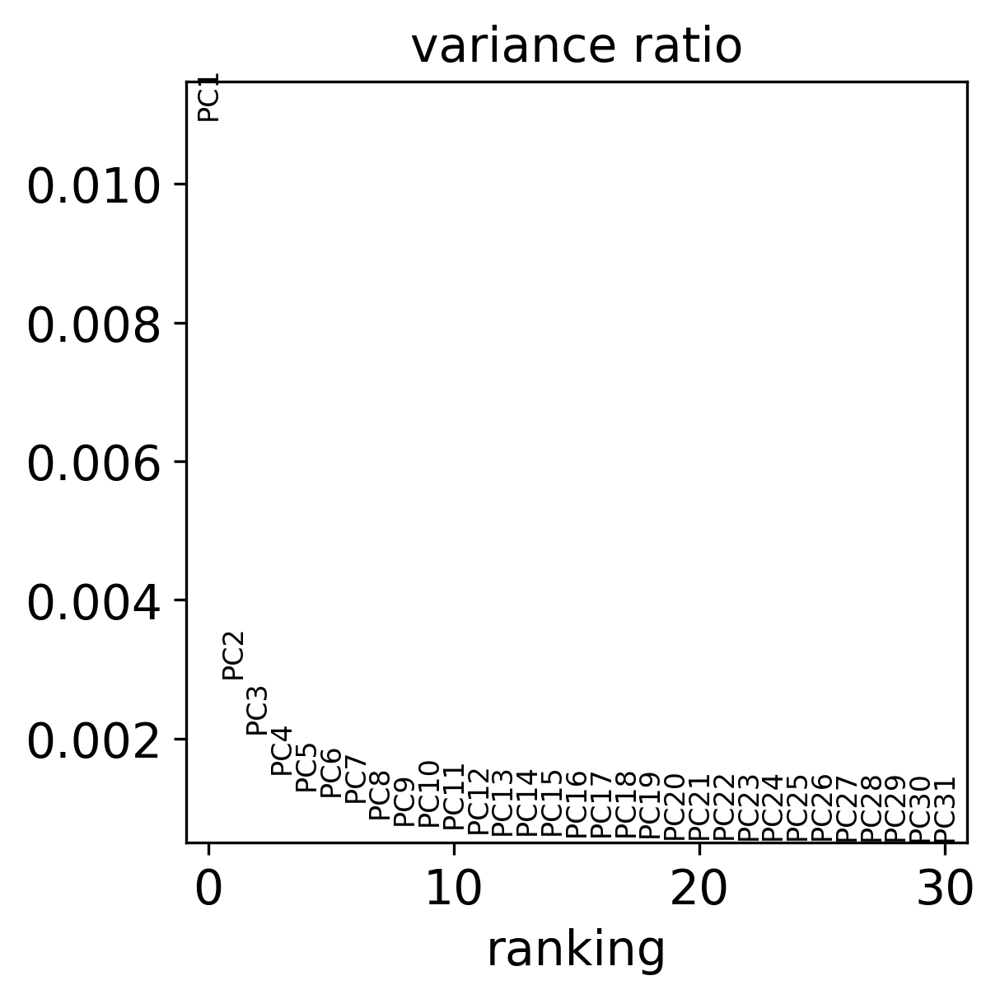

In [18]:
sc.pl.pca_variance_ratio(adata_cd8)

In [20]:
# 3. BATCH CORRECTION
sce.pp.harmony_integrate(adata_cd8, key='donor_id', max_iter_harmony=20)

2024-06-02 15:15:07,666 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-06-02 15:15:10,956 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-06-02 15:15:11,366 - harmonypy - INFO - Iteration 1 of 20
2024-06-02 15:16:19,694 - harmonypy - INFO - Iteration 2 of 20
2024-06-02 15:17:25,384 - harmonypy - INFO - Iteration 3 of 20
2024-06-02 15:18:29,322 - harmonypy - INFO - Iteration 4 of 20
2024-06-02 15:19:32,287 - harmonypy - INFO - Iteration 5 of 20
2024-06-02 15:20:34,504 - harmonypy - INFO - Iteration 6 of 20
2024-06-02 15:21:29,472 - harmonypy - INFO - Iteration 7 of 20
2024-06-02 15:22:19,030 - harmonypy - INFO - Iteration 8 of 20
2024-06-02 15:23:05,253 - harmonypy - INFO - Iteration 9 of 20
2024-06-02 15:23:51,478 - harmonypy - INFO - Iteration 10 of 20
2024-06-02 15:24:37,671 - harmonypy - INFO - Iteration 11 of 20
2024-06-02 15:25:23,917 - harmonypy - INFO - Iteration 12 of 20
2024-06-02 15:26:13,588 - harmonypy - INFO - Iteration 13 of

In [21]:
sc.pp.neighbors(
    adata_cd8,
    n_pcs=15,
    n_neighbors=15,
    knn=True,
    use_rep="X_pca_harmony"
)

In [27]:
sc.tl.leiden(adata_cd8, resolution=0.4, flavor='igraph', key_added='leiden_cd8')
sc.tl.dendrogram(adata_cd8, groupby="leiden_cd8", n_pcs=15, use_rep="X_pca_harmony", linkage_method="single")

In [23]:
sc.tl.paga(adata_cd8)
sc.pl.paga(adata_cd8, plot=False)
sc.tl.umap(adata_cd8, init_pos='paga')

In [24]:
adata_cd8.write_h5ad(os.path.join(output_path, 'adata_cd8_leiden.h5ad'))

In [4]:
adata_cd8 = sc.read_h5ad(os.path.join(output_path, 'adata_cd8_leiden.h5ad'))

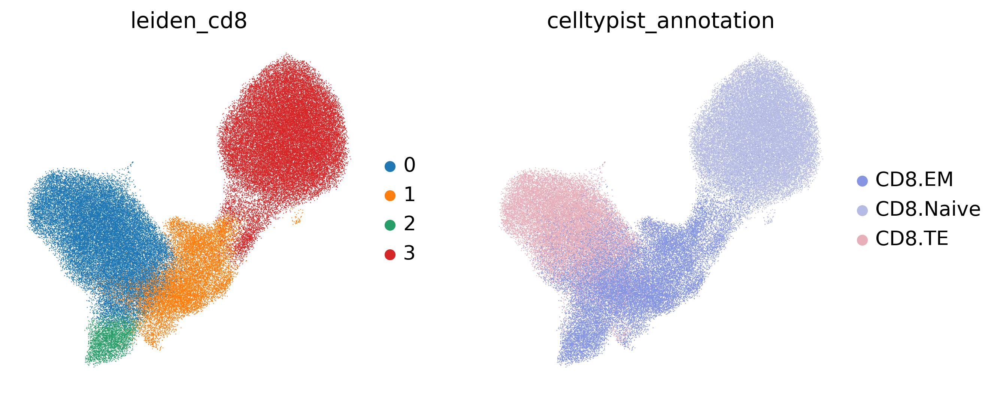

In [37]:
sc.pl.umap(adata_cd8, color=['leiden_cd8', 'celltypist_annotation'])

In [80]:
adata_cd8

AnnData object with n_obs × n_vars = 91681 × 3000
    obs: 'donor_id', 'pool_number', 'age', 'sex', 'dataset', 'ct_cov', 'ethnicity', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'outlier', 'mt_outlier', 'n_genes', 'leiden', 'celltypist_annotation', 'celltypist_conf_score', 'leiden_cd8', 'is_CD8Treg'
    var: 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'celltypist_annotation_colors', 'ct_cov_colors', 'dataset_colors', 'dendrogram_celltypist_annotation', 'dendrogram_leiden', 'dendrogram_leiden_cd8', 'hvg', 'leiden', 'leiden_cd8', 'leiden_colors', 'leiden_sizes', 'log1p', 'neighbors', 'paga', 'pca', 'pool_number_colors

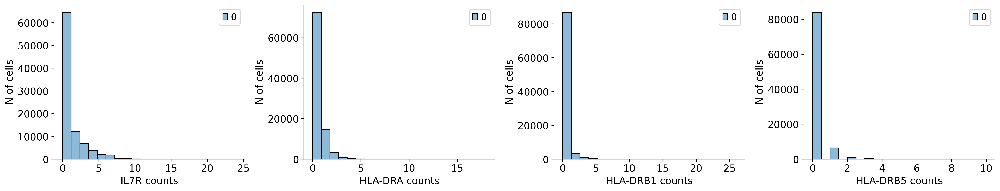

In [73]:
fig, axs = plt.subplots(ncols=4, figsize=(20, 4))

for n, gene in enumerate(['IL7R', 'HLA-DRA', 'HLA-DRB1', 'HLA-DRB5']):
    gene_counts = adata_cd8[:, gene].layers['counts'].A
    sns.histplot(gene_counts, bins=20, ax=axs[n])
    axs[n].set_xlabel(f'{gene} counts')
    axs[n].set_ylabel('N of cells')
plt.tight_layout() 

In [97]:
filtered = adata_cd8[(np.greater(adata_cd8[:, 'HLA-DRA'].layers['counts'].A, 1) 
                      | np.greater(adata_cd8[:, 'HLA-DRB1'].layers['counts'].A, 1)
                      | np.greater(adata_cd8[:, 'HLA-DRB5'].layers['counts'].A, 1))
                    & np.less_equal(adata_cd8[:, 'IL7R'].layers['counts'].A, 0)]
adata_cd8.obs['is_CD8Treg'] = [name in list(filtered.obs_names) for name in adata_cd8.obs_names]
print(adata_cd8.obs['is_CD8Treg'].sum())
f"{adata_cd8.obs['is_CD8Treg'].sum() / adata_cd8.obs['is_CD8Treg'].size * 100:.2f}%"
# 5% Treg of total CD8+ T cells is expected

4790


'5.22%'

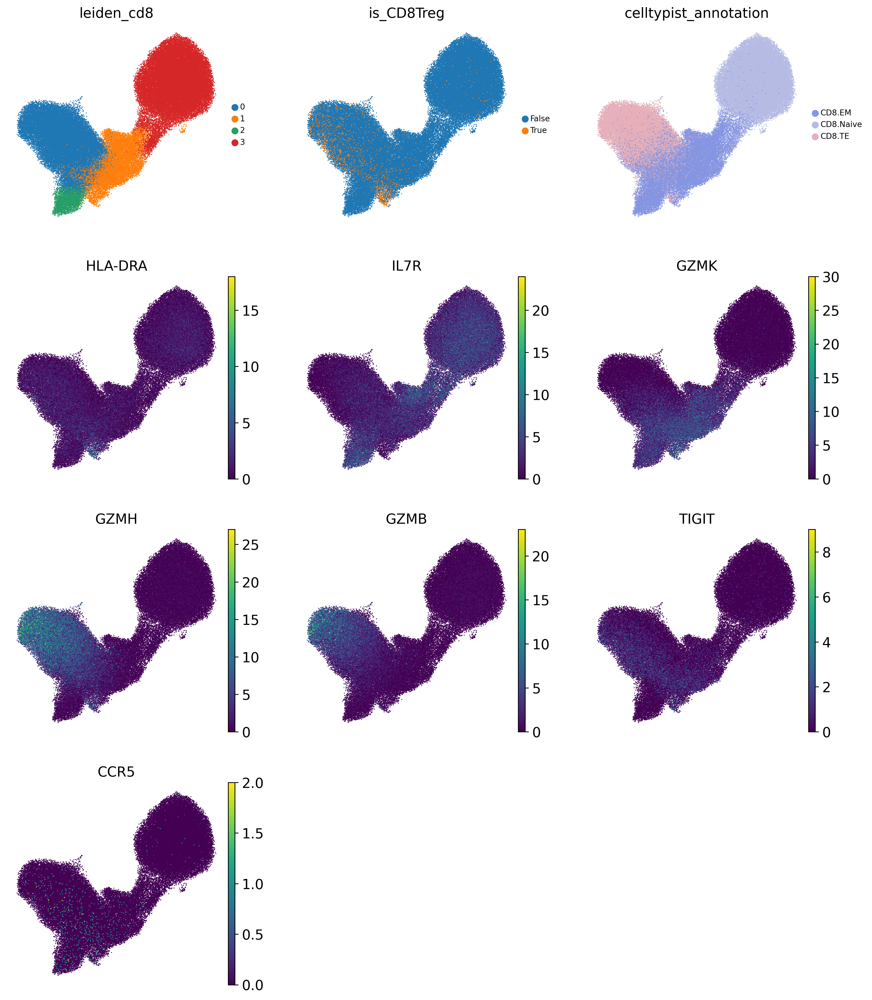

In [98]:
sc.pl.umap(adata_cd8, color=['leiden_cd8', 'is_CD8Treg', 'celltypist_annotation', 'HLA-DRA', 'IL7R', 'GZMK', 'GZMH', 'GZMB', 'TIGIT', 'CCR5'], 
           frameon=False, 
           size=4, 
           ncols=3,
           legend_fontsize=8,         
           sort_order=True
          ) 

In [94]:
adata_cd8.write(os.path.join(output_path, 'adata_cd8_treg_tags.h5ad'))

In [96]:
adata_cd8.obs.value_counts(subset=['celltypist_annotation', 'is_CD8Treg']) 
# Treg in CD8.EM 5.7%, in CD8.TE 11%, in Naive 0.9%

celltypist_annotation  is_CD8Treg
CD8.Naive              False         37339
CD8.EM                 False         28431
CD8.TE                 False         21121
                       True           2729
CD8.EM                 True           1734
CD8.Naive              True            327
dtype: int64

#### Prep tags for DEA

In [4]:
adata_cd8 = sc.read_h5ad(os.path.join(output_path, 'adata_cd8_treg_tags.h5ad'))

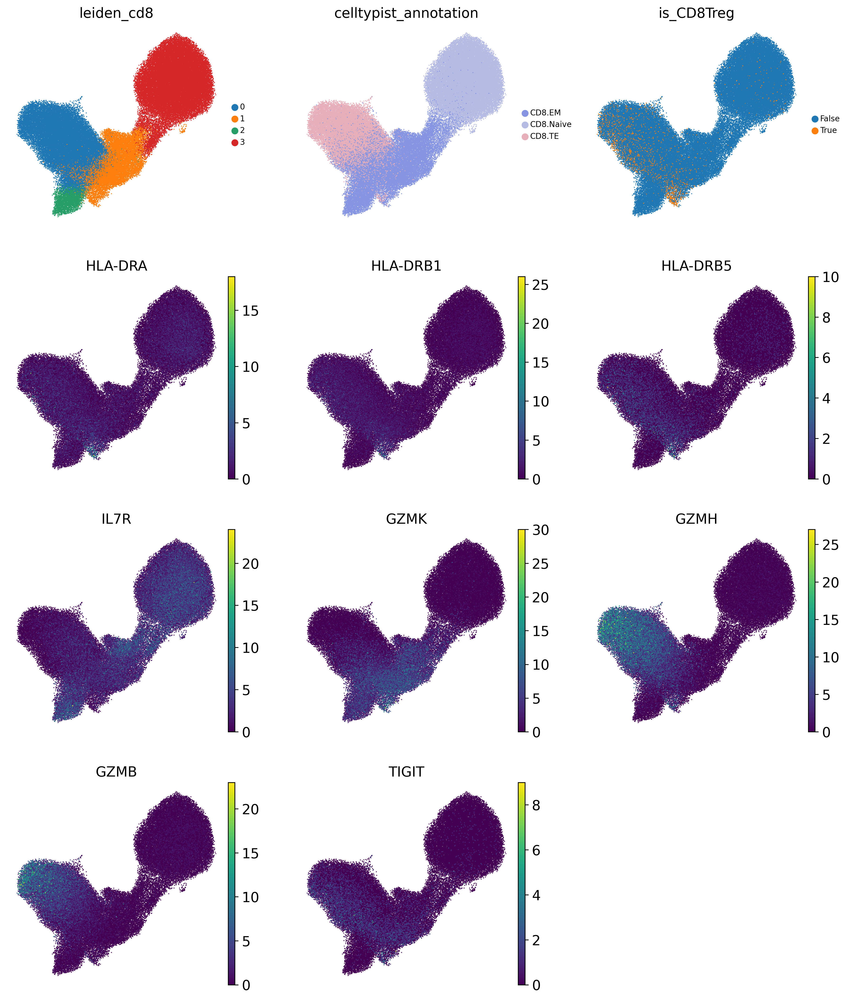

In [95]:
sc.pl.umap(adata_cd8, color=['leiden_cd8', 'celltypist_annotation', 'is_CD8Treg', 'HLA-DRA', 'HLA-DRB1', 
                             'HLA-DRB5', 'IL7R', 'GZMK', 'GZMH', 'GZMB', 'TIGIT'], 
           frameon=False, 
           size=4, 
           ncols=3,
           legend_fontsize=8,         
           # sort_order=False
          ) 

In [99]:
adata_cd8.obs['dea_labels'] = adata_cd8.obs['celltypist_annotation'].astype('object')
adata_cd8.obs['dea_labels'][(adata_cd8.obs['is_CD8Treg'] == True) & (adata_cd8.obs['celltypist_annotation'] != 'CD8.Naive')] = 'CD8.Treg'
adata_cd8.obs['dea_labels'] = adata_cd8.obs['dea_labels'].astype('category')

/tmp/ipykernel_73/3637697928.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_cd8.obs['dea_labels'][(adata_cd8.obs['is_CD8Treg'] == True) & (adata_cd8.obs['celltypist_annotation'] != 'CD8.Naive')] = 'CD8.Treg'


In [100]:
adata_cd8.write('adata_cd8_treg_tags.h5ad')

In [125]:
adata_cd8.obs['dea_labels'].value_counts()

CD8.Naive    37666
CD8.EM       28431
CD8.TE       21121
CD8.Treg      4463
Name: dea_labels, dtype: int64

### 4. sc DEA

In [83]:
adata_cd8 = sc.read_h5ad(os.path.join(output_path, 'adata_cd8_treg_tags.h5ad'))

In [84]:
adata_cd8 = adata_cd8[adata_cd8.obs['dea_labels'] != 'CD8.Naive']

In [89]:
adata_cd8.X = sc.pp.log1p(adata_cd8, layer='counts', copy=True).layers['counts']

In [105]:
sc.tl.rank_genes_groups(adata_cd8, groupby='dea_labels', groups=['CD8.Treg', 'CD8.EM', 'CD8.TE'], 
                        method='wilcoxon', 
                        pts=True,
                        use_raw=False,
                       )

In [114]:
df = sc.get.rank_genes_groups_df(adata_cd8, group='CD8.Treg', pval_cutoff=0.05)

In [117]:
df = df[~df.names.str.startswith('RP')]
df = df[df.pct_nz_group > 0.01]
df = df[df.pvals_adj < 0.01]
df.sort_values(by='logfoldchanges', ascending=False, inplace=True)
df.to_csv(os.path.join(output_path, 'sc_dea.csv'))

/opt/conda/envs/scenv/lib/python3.11/site-packages/scanpy/plotting/_tools/__init__.py:1303: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  _ax.set_xticklabels(new_gene_names, rotation="vertical")


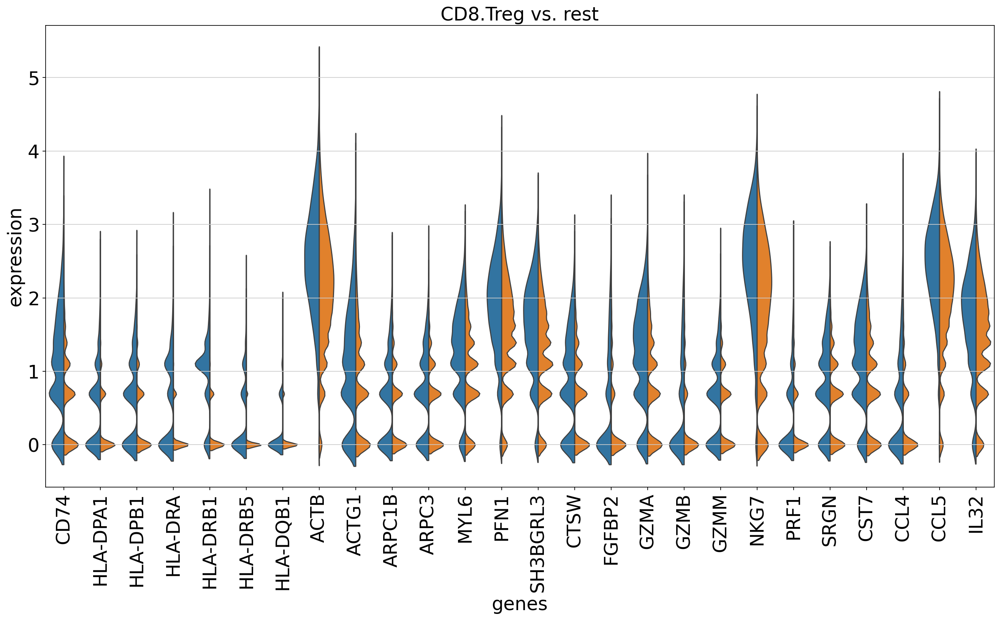

In [112]:
sc.set_figure_params(figsize=(20, 10), fontsize=22)

gene_groups = ['CD74', 'HLA-DPA1', 'HLA-DPB1', 'HLA-DRA', 'HLA-DRB1', 'HLA-DRB5', 'HLA-DQB1',
               'ACTB', 'ACTG1', 'ARPC1B', 'ARPC3', 'MYL6', 'PFN1', 'SH3BGRL3',
               'CTSW', 'FGFBP2', 'GZMA', 'GZMB', 'GZMM', 'NKG7', 'PRF1', 'SRGN',
               'CST7', 'CCL4', 'CCL5', 'IL32']

sc.pl.rank_genes_groups_violin(adata_cd8, jitter=False, size=0, 
                               groups=['CD8.Treg'], 
                               strip=False,
                               gene_names=gene_groups,
                               use_raw=False
                              )

In [304]:
with open('up_signs.txt', 'w') as f:
    for gene in df[df.logfoldchanges > 0.7].names.tolist():
        f.write(f'{gene}\n')
        

In [312]:
df_filt = df[df.logfoldchanges.lt(-0.7) | df.logfoldchanges.gt(0.07)]

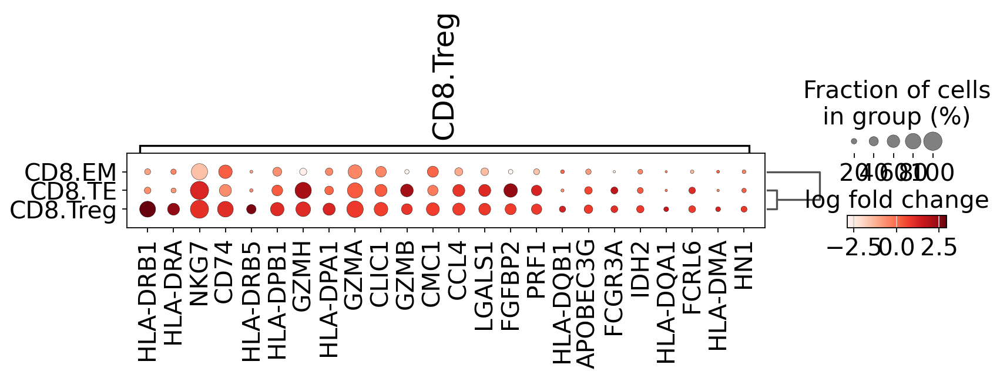

In [113]:
sc.tl.dendrogram(adata_cd8, groupby='dea_labels')
sc.pl.rank_genes_groups_dotplot(
    adata_cd8,
    groups=['CD8.Treg'],
    n_genes=24,
    values_to_plot="logfoldchanges",
    min_logfoldchange=0.7,
    # # cmap="bwr",
)

### 5. Pseudobulk DEA

> Здесь мы будем использовать тест квазиправдоподобия, поскольку он учитывает неопределенность оценок дисперсии. Напротив, точный тест предполагает, что предполагаемая дисперсия является истинным значением, что может привести к некоторой неточности. Кроме того, GLM квазиправдоподобия более гибки, когда дело доходит до планирования эксперимента.

In [32]:
adata_cd8 = sc.read_h5ad(os.path.join(output_path, 'adata_cd8_treg_tags.h5ad'))

In [33]:
adata_cd8 = adata_cd8[adata_cd8.obs['dea_labels'] != 'CD8.Naive']

In [34]:
# return raw counts for DEA:
adata_to_pb = adata_cd8.raw.to_adata().copy()

In [35]:
adata_to_pb.obs["bulk_sample"] = [
    f"{pool}_{cell_type}" for pool, cell_type in zip(adata_to_pb.obs["pool_number"], adata_to_pb.obs["dea_labels"])
]

In [36]:
adata_to_pb.obs["bulk_sample"] = adata_to_pb.obs["bulk_sample"].astype('category')
adata_to_pb.obs["pool_number"] = adata_to_pb.obs["pool_number"].astype('category')
adata_to_pb.obs["dea_labels"] = adata_to_pb.obs["dea_labels"].astype('category')

> define a separate function to fit an edgeR GLM

> `fit_model` takes a SingleCellExperiment object as input, creates the design matrix and outputs the fitted GLM. We also output the edgeR object of class DGEList to do some exploratory data analysis (EDA).

In [37]:
%%R
fit_model <- function(adata_){
    # create an edgeR object with counts and grouping factor
    y <- DGEList(assay(adata_, "X"), group = colData(adata_)$dea_labels)
    
    # filter out genes with low counts
    print("Dimensions before subsetting:")
    print(dim(y))
    print("")
    keep <- filterByExpr(y)
    y <- y[keep, , keep.lib.sizes=FALSE]
    print("Dimensions after subsetting:")
    print(dim(y))
    print("")

    # normalize
    y <- calcNormFactors(y)

    # create a vector that is a concatenation of condition and cell type 
    # that we will later use with contrasts
    ## group <- paste0(colData(adata_)$label, ".", colData(adata_)$cell_type)
    cell_type <- colData(adata_)$dea_labels
    dataset <- colData(adata_)$dataset

    # create a design matrix: 
    # here we have multiple donors so also consider that in the design matrix
    design <- model.matrix(~ 0 + cell_type)

    # estimate dispersion
    y <- estimateDisp(y, design = design)

    # fit the model
    fit <- glmQLFit(y, design)

    return(list("fit"=fit, "design"=design, "y"=y))
}

In [38]:
obs_to_keep = ['age', 'sex', 'pool_number', 'dataset', 'dea_labels', 'bulk_sample']

In [39]:
adata_pb = preprocessing.aggregate_and_filter(adata_to_pb,  
                                donor_key="bulk_sample", 
                                condition_key="dea_labels", 
                                obs_to_keep=obs_to_keep,
                                min_cells_per_donor=30
                               )

Dropping the following samples:
['10.0_CD8.Treg', '12.0_CD8.Treg', '15.0_CD8.Treg', '17.0_CD8.Treg', '18.0_CD8.Treg', '19.0_CD8.Treg', '2.0_CD8.TE', '2.0_CD8.Treg', '23.0_CD8.Treg', '3.0_CD8.Treg', '30.0_CD8.Treg', '31.0_CD8.Treg', '35.0_CD8.Treg', '38.0_CD8.Treg', '39.0_CD8.Treg', '41.0_CD8.Treg', '45.0_CD8.Treg', '47.0_CD8.Treg', '49.0_CD8.Treg', '5.0_CD8.Treg', '50.0_CD8.Treg', '51.0_CD8.Treg', '52.0_CD8.Treg', '55.0_CD8.Treg', '62.0_CD8.Treg', '64.0_CD8.Treg', '67.0_CD8.Treg', '68.0_CD8.Treg', '71.0_CD8.Treg', '73.0_CD8.TE', '73.0_CD8.Treg', '77.0_CD8.Treg', 'dmx_YE_7-19_CD8.Treg', 'dmx_YE_7-20_CD8.TE', 'dmx_YE_7-20_CD8.Treg', 'dmx_YE_7-26_CD8.TE', 'dmx_YE_7-26_CD8.Treg', 'dmx_YE_8-16_CD8.Treg', 'dmx_YE_8-17_CD8.Treg', 'dmx_YE_8-23_CD8.Treg', 'dmx_YE_8-3_CD8.Treg', 'dmx_flare1_CD8.Treg']
	Processing donor 270 out of 270...



In [40]:
adata_pb.obs.head(10)

,age,sex,pool_number,dataset,dea_labels,bulk_sample
1.0_CD8.EM_0,63.0,Female,1.0,OneK1K,CD8.EM,1.0_CD8.EM
1.0_CD8.TE_0,63.0,Female,1.0,OneK1K,CD8.TE,1.0_CD8.TE
1.0_CD8.Treg_0,63.0,Female,1.0,OneK1K,CD8.Treg,1.0_CD8.Treg
10.0_CD8.EM_0,62.0,Male,10.0,OneK1K,CD8.EM,10.0_CD8.EM
10.0_CD8.TE_0,62.0,Male,10.0,OneK1K,CD8.TE,10.0_CD8.TE
11.0_CD8.EM_0,64.0,Male,11.0,OneK1K,CD8.EM,11.0_CD8.EM
11.0_CD8.TE_0,64.0,Male,11.0,OneK1K,CD8.TE,11.0_CD8.TE
11.0_CD8.Treg_0,61.0,Male,11.0,OneK1K,CD8.Treg,11.0_CD8.Treg
12.0_CD8.EM_0,50.0,Male,12.0,OneK1K,CD8.EM,12.0_CD8.EM
12.0_CD8.TE_0,50.0,Male,12.0,OneK1K,CD8.TE,12.0_CD8.TE


In [41]:
adata_pb.obs['age'] = adata_pb.obs['age'].astype('float')
adata_pb.obs['pool_number'] = adata_pb.obs['pool_number'].astype('category')
adata_pb.obs['bulk_sample'] = adata_pb.obs['bulk_sample'].astype('category')

In [42]:
adata_pb.layers['counts'] = adata_pb.X.copy()

sc.pp.normalize_total(adata_pb, target_sum=1e6)
sc.pp.log1p(adata_pb)
sc.pp.pca(adata_pb)

In [43]:
adata_pb.obs["lib_size"] = np.sum(adata_pb.layers["counts"], axis=1)
adata_pb.obs["lib_size"] = adata_pb.obs["lib_size"].astype('float')
adata_pb.obs["log_lib_size"] = np.log(adata_pb.obs["lib_size"])

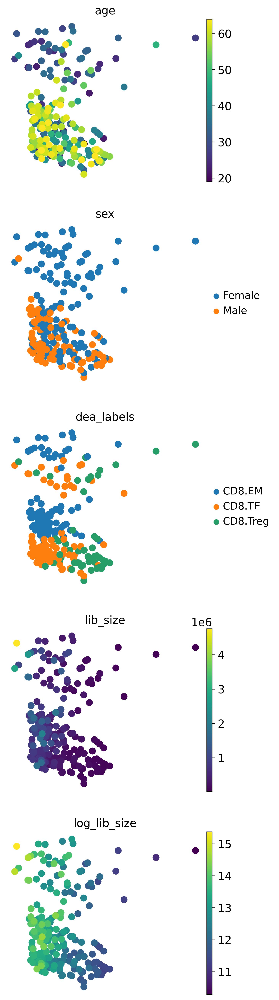

In [44]:
sc.pl.pca(adata_pb, color=['age', 'sex', 'dea_labels', 'lib_size', 'log_lib_size'],
          ncols=1, size=300)

In [45]:
adata_pb.X = adata_pb.layers['counts'].copy()

In [46]:
adata_pb.X = adata_pb.X.astype('float')
adata_pb.X = sparse.csr_matrix(adata_pb.X)

In [47]:
adata_pb.layers['counts'] = adata_pb.layers['counts'].astype('float')
adata_pb.layers['counts'] = sparse.csr_matrix(adata_pb.layers['counts'])

In [48]:
%%time
%%R -i adata_pb
outs <-fit_model(adata_pb)

/opt/conda/envs/scenv/lib/python3.11/functools.py:909: NotConvertedWarning: Conversion 'py2rpy' not defined for objects of type '<class 'NoneType'>'
  return dispatch(args[0].__class__)(*args, **kw)


[1] "Dimensions before subsetting:"
[1] 22226   228
[1] ""
[1] "Dimensions after subsetting:"
[1] 4691  228
[1] ""


In addition: Warning messages:
1: In (function (package, help, pos = 2, lib.loc = NULL, character.only = FALSE,  :
  libraries ‘/usr/local/lib/R/site-library’, ‘/usr/lib/R/site-library’ contain no packages
2: In (function (package, help, pos = 2, lib.loc = NULL, character.only = FALSE,  :
  libraries ‘/usr/local/lib/R/site-library’, ‘/usr/lib/R/site-library’ contain no packages
3: In (function (package, help, pos = 2, lib.loc = NULL, character.only = FALSE,  :
  libraries ‘/usr/local/lib/R/site-library’, ‘/usr/lib/R/site-library’ contain no packages
4: In (function (package, help, pos = 2, lib.loc = NULL, character.only = FALSE,  :
  libraries ‘/usr/local/lib/R/site-library’, ‘/usr/lib/R/site-library’ contain no packages


CPU times: user 8.44 s, sys: 672 ms, total: 9.11 s
Wall time: 9.13 s


In [49]:
%%R
fit <- outs$fit
y <- outs$y

In [50]:
%%R
colnames(y$design)

[1] "cell_typeCD8.EM"   "cell_typeCD8.TE"   "cell_typeCD8.Treg"


In [51]:
%%R -o tt

myContrast <- makeContrasts(contrasts="cell_typeCD8.Treg-(cell_typeCD8.EM+cell_typeCD8.TE)/2", levels = y$design)
qlf <- glmQLFTest(fit, contrast=myContrast)

# get all of the DE genes and calculate Benjamini-Hochberg adjusted FDR
tt <- topTags(qlf, n = Inf, adjust.method='fdr', p.value=1)
tt <- tt$table

In [52]:
tt.shape

(4691, 5)

In [53]:
tt

,logFC,logCPM,F,PValue,FDR
HLA-DRB1,2.567650,7.874231,2.387893e+03,1.307668e-125,6.134272e-122
IL7R,-10.376938,8.298208,1.456265e+03,8.279766e-90,1.942019e-86
HLA-DRB5,2.422016,6.339267,5.228937e+02,8.875250e-62,1.387793e-58
HLA-DRA,2.371843,7.273371,4.767613e+02,1.308617e-58,1.534681e-55
CD74,0.950142,9.363587,3.699755e+02,2.782613e-50,2.610648e-47
HLA-DPA1,0.907600,7.873174,2.845001e+02,1.891203e-42,1.478605e-39
HLA-DPB1,0.782953,8.364109,2.766651e+02,1.138263e-41,7.627986e-39
HLA-DQB1,1.131868,6.066095,2.029618e+02,1.220608e-33,7.157337e-31
HLA-DMA,1.044332,5.516302,1.573265e+02,5.693901e-28,2.967788e-25
RPL32,-0.298138,12.877284,1.347506e+02,5.885956e-25,2.761102e-22


In [54]:
tt[tt.PValue < 0.05].shape

(1312, 5)

In [55]:
tt = tt[tt.PValue < 0.05]

In [57]:
tt = tt.sort_values(by='logFC', ascending=False)
tt.to_csv(os.path.join(output_path, 'pd_dea_raw.csv'))

In [58]:
tt_filt = tt[~ tt.index.str.startswith('RP')]
tt_filt.to_csv(os.path.join(output_path, 'pd_dea_non_rb_all.csv'))
tt_filt[tt_filt.logFC > 0.5].to_csv(os.path.join(output_path, 'pd_dea_non_rb_up.csv'))
tt_filt[tt_filt.logFC < -0.5].to_csv(os.path.join(output_path, 'pd_dea_non_rb_down.csv'))

In [38]:
with open(os.path.join(output_path, 'up_genes.txt'), 'w') as f:
    for gene in tt_filt[tt_filt.logFC > 0.5].index.tolist():
        f.write(f'{gene}\n')

with open(os.path.join(output_path, 'down_genes.txt'), 'w') as f:
    for gene in tt_filt[tt_filt.logFC < -0.5].index.tolist():
        f.write(f'{gene}\n')

### 6. Pseudobulk functional analysis

In [17]:
tt = pd.read_csv(os.path.join(output_path, 'pd_dea_all.csv'))
tt.index = tt['Unnamed: 0']
tt = tt.drop(columns=['Unnamed: 0'])
tt_filt = tt[~ tt.index.str.startswith('RP')]

In [19]:
%%R -i tt_filt

# prepare input

original_gene_list <- tt_filt$logFC
names(original_gene_list) <- rownames(tt_filt)

# omit any NA values (if nesessary) 
gene_list <- na.omit(original_gene_list)

# # sort the list in decreasing order (required for clusterProfiler)
gene_list <- sort(gene_list, decreasing = TRUE)

In [20]:
%%R

keytypes(org.Hs.eg.db)

 [1] "ACCNUM"       "ALIAS"        "ENSEMBL"      "ENSEMBLPROT"  "ENSEMBLTRANS"
 [6] "ENTREZID"     "ENZYME"       "EVIDENCE"     "EVIDENCEALL"  "GENENAME"    
[11] "GENETYPE"     "GO"           "GOALL"        "IPI"          "MAP"         
[16] "OMIM"         "ONTOLOGY"     "ONTOLOGYALL"  "PATH"         "PFAM"        
[21] "PMID"         "PROSITE"      "REFSEQ"       "SYMBOL"       "UCSCKG"      
[26] "UNIPROT"     


In [25]:
%%R

gse <- gseGO(geneList=gene_list, 
             ont ="ALL", 
             keyType = "ALIAS",  
             minGSSize = 3, 
             maxGSSize = 800, 
             pvalueCutoff = 0.05, 
             verbose = TRUE, 
             OrgDb = "org.Hs.eg.db", 
             pAdjustMethod = "BH")
gse <- pairwise_termsim(gse)

gse_simplified <- simplify(gse, cutoff = 0.7, by = "p.adjust", select_fun = min)

using 'fgsea' for GSEA analysis, please cite Korotkevich et al (2019).

preparing geneSet collections...
GSEA analysis...
leading edge analysis...
done...
In addition: Warning message:
In fgseaMultilevel(pathways = pathways, stats = stats, minSize = minSize,  :
  For some pathways, in reality P-values are less than 1e-10. You can set the `eps` argument to zero for better estimation.


In [62]:
%%R

gse

#
# Gene Set Enrichment Analysis
#
#...@organism 	 Homo sapiens 
#...@setType 	 GOALL 
#...@keytype 	 ALIAS 
#...@geneList 	 Named num [1:1218] 2.57 2.42 2.37 1.31 1.15 ...
 - attr(*, "names")= chr [1:1218] "HLA-DRB1" "HLA-DRB5" "HLA-DRA" "HLA-DQA1" ...
#...nPerm 	 
#...pvalues adjusted by 'BH' with cutoff <0.05 
#...212 enriched terms found
'data.frame':	212 obs. of  12 variables:
 $ ONTOLOGY       : chr  "MF" "MF" "MF" "BP" ...
 $ ID             : chr  "GO:0023023" "GO:0042277" "GO:0033218" "GO:0048002" ...
 $ Description    : chr  "MHC protein complex binding" "peptide binding" "amide binding" "antigen processing and presentation of peptide antigen" ...
 $ setSize        : int  20 32 39 17 14 25 14 13 55 12 ...
 $ enrichmentScore: num  0.92 0.76 0.703 0.91 0.959 ...
 $ NES            : num  3.41 3.24 3.17 3.16 3.14 ...
 $ pvalue         : num  1e-10 1e-10 1e-10 1e-10 1e-10 ...
 $ p.adjust       : num  2.19e-08 2.19e-08 2.19e-08 2.19e-08 2.19e-08 ...
 $ qvalue         : num  2.01e-08

In [65]:
%%R 
gse_df <- as.data.frame(gse)
write.csv(gse_df, file = "signs_gsea_results.csv", row.names = TRUE)

Scale for y is already present.
Adding another scale for y, which will replace the existing scale.


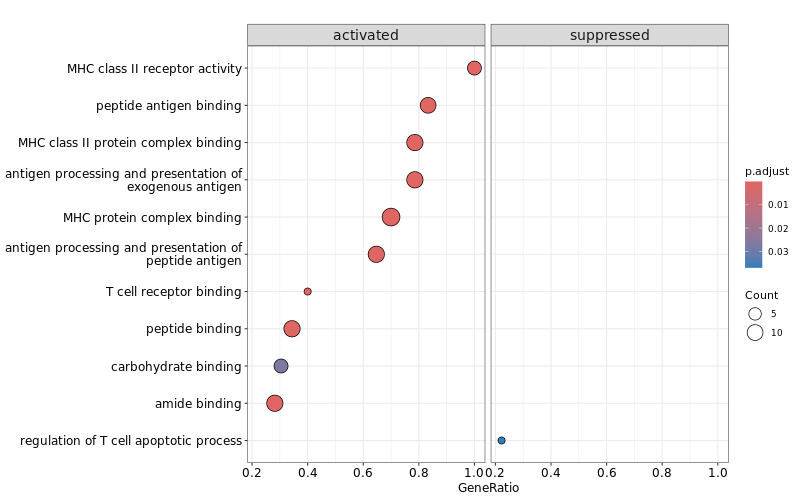

In [26]:
%%R -w 800 -h 500

require(DOSE)

dotplot(gse_simplified, showCategory=10, split=".sign") + 
    facet_grid(.~.sign) +
    theme(axis.text.y = element_text(size = 12, vjust=0.5), strip.text = element_text(size = 14)) +
    scale_y_discrete(labels = scales::label_wrap(40))

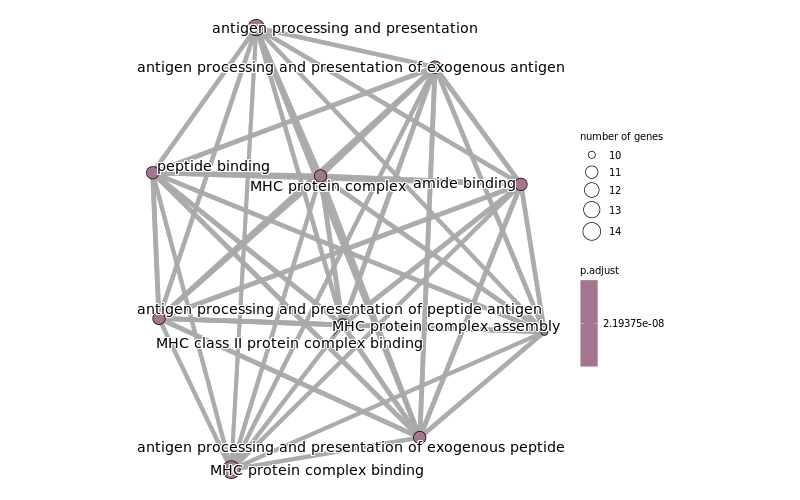

In [89]:
%%R -w 800 -h 500

emapplot(gse, showCategory = 10)